In [1]:
from shapely.geometry import Point
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster

%matplotlib inline

### 911 Calls Derecho
### 1549 rows
### 5/3/2020 16:30 - 5/4/2020 0:29

In [2]:
phone911_derecho = pd.read_csv('../data/911_Phone Calls_Derecho_050320 050420.csv')
print(phone911_derecho.shape)
phone911_derecho.info()
phone911_derecho.head(10)

(1549, 5)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1549 entries, 0 to 1548
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Seizure DateTime    1549 non-null   object 
 1   CallTypeId          1549 non-null   object 
 2   ALI Latitude        1483 non-null   float64
 3   ALI Longitude       1483 non-null   float64
 4   Cell Tower Address  1525 non-null   object 
dtypes: float64(2), object(3)
memory usage: 60.6+ KB


,Seizure DateTime,CallTypeId,ALI Latitude,ALI Longitude,Cell Tower Address
0,5/3/2020 16:30,911 Calls,36.247802,-86.716847,WIRELESS CALLER
1,5/3/2020 16:30,911 Calls,36.143108,-86.800621,1161 21ST AV S - SE
2,5/3/2020 16:30,911 Calls,36.100516,-87.056329,8013 C MCCRORY LN - N
3,5/3/2020 16:30,911 Calls,36.130021,-86.927819,5758 RIVER RD - SW
4,5/3/2020 16:31,911 Calls,36.142380,-86.881882,3744B ANNEX AVE - SE
5,5/3/2020 16:31,911 Calls,36.136683,-86.861322,3744B ANNEX AVE - SE
6,5/3/2020 16:31,911 Calls,36.047151,-86.962538,WIRELESS CALLER
7,5/3/2020 16:32,911 Calls,36.041454,-86.665907,WIRELESS CALLER
8,5/3/2020 16:32,911 Calls,36.093789,-86.839306,5043 G HILLSBORO PIKE - W
9,5/3/2020 16:32,911 Calls,36.030716,-86.981613,8621C HASELTON RD - NE


In [3]:
phone911_derecho=phone911_derecho.rename(columns={'Seizure DateTime':'date_time','CallTypeId':'call_type','ALI Latitude':'lat','ALI Longitude':'lng','Cell Tower Address':'cell_address'})
phone911_derecho.head()

,date_time,call_type,lat,lng,cell_address
0,5/3/2020 16:30,911 Calls,36.247802,-86.716847,WIRELESS CALLER
1,5/3/2020 16:30,911 Calls,36.143108,-86.800621,1161 21ST AV S - SE
2,5/3/2020 16:30,911 Calls,36.100516,-87.056329,8013 C MCCRORY LN - N
3,5/3/2020 16:30,911 Calls,36.130021,-86.927819,5758 RIVER RD - SW
4,5/3/2020 16:31,911 Calls,36.142380,-86.881882,3744B ANNEX AVE - SE


In [4]:
phone911_derecho.isnull().sum()

date_time        0
call_type        0
lat             66
lng             66
cell_address    24
dtype: int64

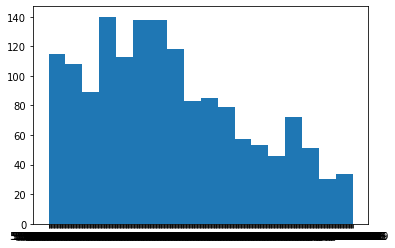

In [5]:
plt.hist('date_time', bins = 18, data = phone911_derecho);

### 911 Tornado
### 475 rows
### 3/3/2020 0:34 - 3/3/2020 4:58

In [6]:
phone911_tornado = pd.read_csv('../data/911_Phone_Calls_Tornado_030320.csv')
print(phone911_tornado.shape)
phone911_tornado.info()
phone911_tornado.tail()

(475, 5)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 475 entries, 0 to 474
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Seizure DateTime    475 non-null    object 
 1   CallTypeId          475 non-null    object 
 2   ALI Latitude        450 non-null    float64
 3   ALI Longitude       450 non-null    float64
 4   Cell Tower Address  468 non-null    object 
dtypes: float64(2), object(3)
memory usage: 18.7+ KB


,Seizure DateTime,CallTypeId,ALI Latitude,ALI Longitude,Cell Tower Address
470,3/3/2020 4:54,911 Calls,36.142552,-86.635330,WIRELESS CALLER
471,3/3/2020 4:54,911 Calls,36.189415,-86.813557,WIRELESS CALLER
472,3/3/2020 4:55,911 Calls,36.223534,-86.757874,WIRELESS CALLER
473,3/3/2020 4:56,911 Calls,36.168398,-86.783774,600 DR MARTIN L KING JR BLVD - NE
474,3/3/2020 4:58,911 Calls,36.276566,-86.799417,4884 LICKTON PIKE - SE


In [7]:
phone911_tornado=phone911_tornado.rename(columns={'Seizure DateTime':'date_time','CallTypeId':'call_type','ALI Latitude':'lat','ALI Longitude':'lng','Cell Tower Address':'cell_address'})
phone911_tornado.head()

,date_time,call_type,lat,lng,cell_address
0,3/3/2020 0:34,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector
1,3/3/2020 0:36,911 Calls,36.159634,-86.841904,4507D KENTUCKY AV - SE
2,3/3/2020 0:36,911 Calls,36.264153,-86.708862,329 THELMA ST - S Sector
3,3/3/2020 0:36,911 Calls,NaN,NaN,526 FOUNDRY DR
4,3/3/2020 0:36,911 Calls,36.233467,-86.721077,5007B RUSKIN AVE - N


In [8]:
phone911_tornado.isnull().sum()

date_time        0
call_type        0
lat             25
lng             25
cell_address     7
dtype: int64

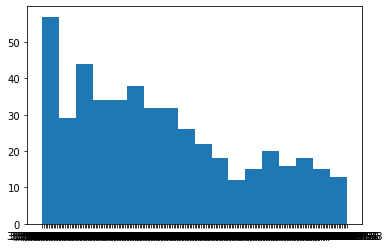

In [9]:
plt.hist('date_time', bins = 18, data = phone911_tornado);

### Dispatch Derecho
### 625 rows
### 5/3/2020 4:31:07 - 5/4/2020 12:29:05

In [10]:
dispatch_derecho = pd.read_csv('../data/Computer Aided Dispatch Data_Derecho Incidents 050320-050420.csv', skiprows=3,error_bad_lines=False)
print(dispatch_derecho.shape)
dispatch_derecho.info()
dispatch_derecho.tail()

(625, 5)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 625 entries, 0 to 624
Data columns (total 5 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Incident	"Date                625 non-null    object 
 1   Loc"	"ation                   625 non-null    object 
 2   Latitude1                     625 non-null    float64
 3   Longitude1                    625 non-null    float64
 4   IncidentTypeDescription1"			  625 non-null    object 
dtypes: float64(2), object(3)
memory usage: 24.5+ KB


b'Skipping line 602: expected 5 fields, saw 9\n'


,"Incident\t""Date","Loc""\t""ation",Latitude1,Longitude1,"IncidentTypeDescription1""\t\t\t"
620,"5/4/2020\t12:21:00\t""0 AM",625 BENTON AV,36.131384,-86.770628,"HIGH RISE NATURAL GAS ODOR""\t\t\t"
621,"5/4/2020\t12:21:03\t""2 AM",518 BRENTLAWN DR,36.064362,-86.761199,"UNKNOWN STATUS""\t\t\t"
622,"5/4/2020\t12:22:04\t""7 AM",517 ALBANY DR,36.212754,-86.600431,"ELECTRICAL HAZARD""\t\t\t"
623,"5/4/2020\t12:27:05\t""2 AM",639 LAFAYETTE ST,36.153769,-86.777520,"SICK PERSON: NO PRIORIT""\tY SYMPTOMS\t\t"
624,"5/4/2020\t12:29:05\t""0 AM",2011 HAYES ST,36.151839,-86.800791,"PULL STATION ALARM COMMER""\tCIAL IND\tUST\tR..."


In [11]:
dispatch_derecho=dispatch_derecho.rename(columns={'Incident\t"Date':'date_time','Loc"\t"ation':'address','Latitude1':'lat','Longitude1':'lng','IncidentTypeDescription1"\t\t\t':'description'})
dispatch_derecho.head()

,date_time,address,lat,lng,description
0,"5/3/2020\t4:31:07\t""PM",901 KENWICK CT W,36.046877,-86.962526,"ELECTRICAL HAZARD""\t\t\t"
1,"5/3/2020\t4:32:18\t""PM",8036 ARBOR DR,36.082491,-86.940680,"ELECTRICAL HAZARD""\t\t\t"
2,"5/3/2020\t4:32:23\t""PM",119 DUE WEST AV E,36.248029,-86.716875,"NOT ALERT COPD""\t\t\t"
3,"5/3/2020\t4:33:04\t""PM",630 GALLATIN PKE S,36.256491,-86.714817,"ABDOMINAL PAIN""\t\t\t"
4,"5/3/2020\t4:33:52\t""PM",615 W HILLWOOD DR,36.129690,-86.879834,"ELECTRICAL HAZARD""\t\t\t"


In [12]:
dispatch_derecho.isnull().sum()

date_time      0
address        0
lat            0
lng            0
description    0
dtype: int64

### Fix Time

In [13]:
cleaned = dispatch_derecho['date_time'].str.split('\t',expand=True).rename(columns={0:'date',1:'time',2:'pm'})
#cleaned=dispatch_derecho['date_time'].str.strip('\t')
cleaned.head()

,date,time,pm
0,5/3/2020,4:31:07,"""PM"
1,5/3/2020,4:32:18,"""PM"
2,5/3/2020,4:32:23,"""PM"
3,5/3/2020,4:33:04,"""PM"
4,5/3/2020,4:33:52,"""PM"


In [14]:
cleaned['date_time'] = pd.to_datetime(cleaned['date'].apply(str)+' '+cleaned['time'])
cleaned.head()

,date,time,pm,date_time
0,5/3/2020,4:31:07,"""PM",2020-05-03 04:31:07
1,5/3/2020,4:32:18,"""PM",2020-05-03 04:32:18
2,5/3/2020,4:32:23,"""PM",2020-05-03 04:32:23
3,5/3/2020,4:33:04,"""PM",2020-05-03 04:33:04
4,5/3/2020,4:33:52,"""PM",2020-05-03 04:33:52


In [15]:
dispatch_derecho2 = pd.merge(dispatch_derecho, cleaned, 
                left_index=True, right_index=True, 
                               how = 'inner')
dispatch_derecho2.head()

,date_time_x,address,lat,lng,description,date,time,pm,date_time_y
0,"5/3/2020\t4:31:07\t""PM",901 KENWICK CT W,36.046877,-86.962526,"ELECTRICAL HAZARD""\t\t\t",5/3/2020,4:31:07,"""PM",2020-05-03 04:31:07
1,"5/3/2020\t4:32:18\t""PM",8036 ARBOR DR,36.082491,-86.940680,"ELECTRICAL HAZARD""\t\t\t",5/3/2020,4:32:18,"""PM",2020-05-03 04:32:18
2,"5/3/2020\t4:32:23\t""PM",119 DUE WEST AV E,36.248029,-86.716875,"NOT ALERT COPD""\t\t\t",5/3/2020,4:32:23,"""PM",2020-05-03 04:32:23
3,"5/3/2020\t4:33:04\t""PM",630 GALLATIN PKE S,36.256491,-86.714817,"ABDOMINAL PAIN""\t\t\t",5/3/2020,4:33:04,"""PM",2020-05-03 04:33:04
4,"5/3/2020\t4:33:52\t""PM",615 W HILLWOOD DR,36.129690,-86.879834,"ELECTRICAL HAZARD""\t\t\t",5/3/2020,4:33:52,"""PM",2020-05-03 04:33:52


In [16]:
dispatch_derecho2 = dispatch_derecho2.drop(columns = ['date_time_x','date','time','pm'])
dispatch_derecho2 = dispatch_derecho2.rename(columns={'date_time_y':'date_time'})
dispatch_derecho2.head()

,address,lat,lng,description,date_time
0,901 KENWICK CT W,36.046877,-86.962526,"ELECTRICAL HAZARD""\t\t\t",2020-05-03 04:31:07
1,8036 ARBOR DR,36.082491,-86.940680,"ELECTRICAL HAZARD""\t\t\t",2020-05-03 04:32:18
2,119 DUE WEST AV E,36.248029,-86.716875,"NOT ALERT COPD""\t\t\t",2020-05-03 04:32:23
3,630 GALLATIN PKE S,36.256491,-86.714817,"ABDOMINAL PAIN""\t\t\t",2020-05-03 04:33:04
4,615 W HILLWOOD DR,36.129690,-86.879834,"ELECTRICAL HAZARD""\t\t\t",2020-05-03 04:33:52


C:\Users\balle\Anaconda3\envs\geospatial\lib\site-packages\matplotlib\backends\backend_agg.py:238: RuntimeWarning: Glyph 9 missing from current font.
  font.set_text(s, 0.0, flags=flags)
C:\Users\balle\Anaconda3\envs\geospatial\lib\site-packages\matplotlib\backends\backend_agg.py:201: RuntimeWarning: Glyph 9 missing from current font.
  font.set_text(s, 0, flags=flags)


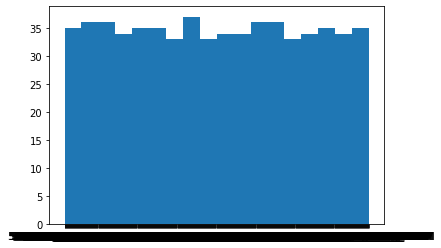

In [17]:
plt.hist('date_time', bins = 18, data = dispatch_derecho);

### Dispatch Tornado
### 260 rows
### 3/3/2020 12:36:34 AM - 3/3/2020 4:57:48 AM

In [18]:
dispatch_tornado = pd.read_csv('../data/Computer Aided Dispatch Data_Tornado Incidents 030320.csv', skiprows=3)
print(dispatch_tornado.shape)
dispatch_tornado.info()
dispatch_tornado.tail()

(260, 5)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260 entries, 0 to 259
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   IncidentDate              260 non-null    object 
 1   Location                  260 non-null    object 
 2   Latitude1                 260 non-null    float64
 3   Longitude1                260 non-null    float64
 4   IncidentTypeDescription1  260 non-null    object 
dtypes: float64(2), object(3)
memory usage: 10.3+ KB


,IncidentDate,Location,Latitude1,Longitude1,IncidentTypeDescription1
255,3/3/2020 4:53:43 AM,1616 23RD AV N,36.175739,-86.813173,WIRES DOWN WITH NO SMOKE OR ARCING POWER DISCO...
256,3/3/2020 4:56:56 AM,5610 OLD HICKORY BLVD,36.180487,-86.601466,LARGE BUILDING INVESTIGATION
257,3/3/2020 4:57:06 AM,2903 MORNINGSIDE DR,36.223554,-86.757949,CHEST PAIN - ABNORMAL BREATHING
258,3/3/2020 4:57:14 AM,1730 KELLOW ST,36.189445,-86.813466,ABNORMAL BREATHING OTHER LUNG PROBLEMS
259,3/3/2020 4:57:48 AM,I24 W / HICKORY HOLLOW PKWY,36.039720,-86.649099,UNKNOWN STATUS:


In [19]:
dispatch_tornado=dispatch_tornado.rename(columns={'IncidentDate':'date_time','Location':'address','Latitude1':'lat','Longitude1':'lng','IncidentTypeDescription1':'description'})
dispatch_tornado.head()

,date_time,address,lat,lng,description
0,3/3/2020 12:36:34 AM,6205 COCKRILL BEND CIR,36.182002,-86.894052,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD
1,3/3/2020 12:37:24 AM,7337 COCKRILL BEND BLVD,36.175666,-86.894978,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD
2,3/3/2020 12:38:17 AM,110 TUNE AIRPORT DR,36.179299,-86.883727,STRUCTURE FIRE COMMERCIAL INDUSTRIAL
3,3/3/2020 12:39:40 AM,555 MARRIOTT DR,36.151108,-86.689921,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD
4,3/3/2020 12:39:42 AM,1414 COUNTY HOSPITAL RD,36.177926,-86.845934,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD


In [20]:
dispatch_tornado.isnull().sum()

date_time      0
address        0
lat            0
lng            0
description    0
dtype: int64

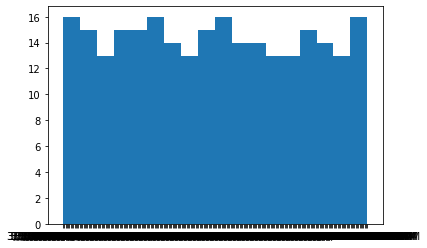

In [21]:
plt.hist('date_time', bins = 18, data = dispatch_tornado);

### Drop Null Lat Rows

In [22]:
phone911_derecho = phone911_derecho.dropna(subset=['lat'])
phone911_tornado = phone911_tornado.dropna(subset=['lat'])
dispatch_derecho = dispatch_derecho.dropna(subset=['lat'])
dispatch_tornado = dispatch_tornado.dropna(subset=['lat'])
phone911_derecho.info()
phone911_tornado.info()
dispatch_derecho.info()
dispatch_tornado.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1483 entries, 0 to 1547
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   date_time     1483 non-null   object 
 1   call_type     1483 non-null   object 
 2   lat           1483 non-null   float64
 3   lng           1483 non-null   float64
 4   cell_address  1483 non-null   object 
dtypes: float64(2), object(3)
memory usage: 69.5+ KB
<class 'pandas.core.frame.DataFrame'>
Int64Index: 450 entries, 0 to 474
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   date_time     450 non-null    object 
 1   call_type     450 non-null    object 
 2   lat           450 non-null    float64
 3   lng           450 non-null    float64
 4   cell_address  450 non-null    object 
dtypes: float64(2), object(3)
memory usage: 21.1+ KB
<class 'pandas.core.frame.DataFrame'>
Int64Index: 625 entries, 0 to 624
Data colum

### Convert date_time to date_time object

In [23]:
phone911_derecho['date_time']=pd.to_datetime(phone911_derecho['date_time'])
phone911_tornado['date_time']=pd.to_datetime(phone911_tornado['date_time'])
dispatch_derecho2['date_time']=pd.to_datetime(dispatch_derecho2['date_time'])
dispatch_tornado['date_time']=pd.to_datetime(dispatch_tornado['date_time'])
#phone911_derecho.head()
#phone911_tornado.head()
#dispatch_derecho2.head()
dispatch_tornado.head()

,date_time,address,lat,lng,description
0,2020-03-03 00:36:34,6205 COCKRILL BEND CIR,36.182002,-86.894052,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD
1,2020-03-03 00:37:24,7337 COCKRILL BEND BLVD,36.175666,-86.894978,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD
2,2020-03-03 00:38:17,110 TUNE AIRPORT DR,36.179299,-86.883727,STRUCTURE FIRE COMMERCIAL INDUSTRIAL
3,2020-03-03 00:39:40,555 MARRIOTT DR,36.151108,-86.689921,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD
4,2020-03-03 00:39:42,1414 COUNTY HOSPITAL RD,36.177926,-86.845934,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD


### Concat the two tornado datasets

In [24]:
#add type columns
phone911_tornado["type"] = '911 call'
dispatch_tornado["type"] = 'dispatch'

#concat
combined_tornados = pd.concat([phone911_tornado, dispatch_tornado])
combined_tornados['date_time'] = combined_tornados['date_time'].dt.strftime('%m-%d %H:%M:%S')
combined_tornados.head()

,date_time,call_type,lat,lng,cell_address,type,address,description
0,03-03 00:34:00,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector,911 call,NaN,NaN
1,03-03 00:36:00,911 Calls,36.159634,-86.841904,4507D KENTUCKY AV - SE,911 call,NaN,NaN
2,03-03 00:36:00,911 Calls,36.264153,-86.708862,329 THELMA ST - S Sector,911 call,NaN,NaN
4,03-03 00:36:00,911 Calls,36.233467,-86.721077,5007B RUSKIN AVE - N,911 call,NaN,NaN
5,03-03 00:37:00,911 Calls,36.149032,-86.795747,WIRELESS CALLER,911 call,NaN,NaN


### tornado 911 map

In [25]:
map_911_tornado = folium.Map(location = (36.174465,-86.767960), zoom_start = 12)
locations = phone911_tornado[['lat', 'lng']].values.tolist()
map_911_tornado.add_child(
    FastMarkerCluster(locations)
)
map_911_tornado

### Derecho, hardest hit areas, two zip codes (37211, 37203), cluster in terms of 911 calls, these two are the top two zip codes in terms of number of calls, after this really drops off in number. Compare pop’n density in different zip codes along path of tornado with where calls came in. Have a tiered labeling system. Calls relative to the population in zip code.
### map pop by zip, then overlay calls

In [26]:
population = pd.read_csv('../data/pop_by_zip_clean.csv')
zipcodes = gpd.read_file('../data/zipcodes.geojson')
population["zip"] = population["zip"].astype(int)
zipcodes["zip"] = zipcodes["zip"].astype(int)
#zipcodes.head()
population.head()

,zip,population,lat,lng,tornado_calls
0,37013,"97,819",36.0593,-86.6706,17.0
1,37042,"77,168",NaN,NaN,NaN
2,37211,"76,834",36.0775,-86.7316,5.0
3,37075,"65,123",NaN,NaN,NaN
4,37167,"59,055",NaN,NaN,NaN


In [27]:
population["population"]=population["population"].str.replace(',','').astype(int)
population.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 615 entries, 0 to 614
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   zip            615 non-null    int32  
 1   population     615 non-null    int32  
 2   lat            26 non-null     float64
 3   lng            26 non-null     float64
 4   tornado_calls  26 non-null     float64
dtypes: float64(3), int32(2)
memory usage: 19.3 KB


### merge to add population to zipcodes

In [28]:
zip_pop = pd.merge(zipcodes, population, on='zip',
                left_index=True, right_index=True, 
                               how = 'inner')
zip_pop.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 56 entries, 0 to 55
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   zip             56 non-null     int32   
 1   objectid        56 non-null     object  
 2   po_name         56 non-null     object  
 3   shape_stlength  56 non-null     object  
 4   shape_starea    56 non-null     object  
 5   geometry        56 non-null     geometry
 6   population      56 non-null     int32   
 7   lat             7 non-null      float64 
 8   lng             7 non-null      float64 
 9   tornado_calls   7 non-null      float64 
dtypes: float64(3), geometry(1), int32(2), object(4)
memory usage: 4.4+ KB


### For tornados - create a geometry column that is a Point datatype

In [34]:
phone911_tornado['geometry'] = phone911_tornado.apply(lambda x: Point((float(x.lng), 
                                                         float(x.lat))), 
                                        axis=1)
phone911_tornado.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 450 entries, 0 to 474
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   date_time     450 non-null    datetime64[ns]
 1   call_type     450 non-null    object        
 2   lat           450 non-null    float64       
 3   lng           450 non-null    float64       
 4   cell_address  450 non-null    object        
 5   type          450 non-null    object        
 6   geometry      450 non-null    object        
dtypes: datetime64[ns](1), float64(2), object(4)
memory usage: 28.1+ KB


In [35]:
tornado_geo = gpd.GeoDataFrame(phone911_tornado, 
                           crs = zipcodes.crs, 
                           geometry = phone911_tornado['geometry'])
type(tornado_geo)

geopandas.geodataframe.GeoDataFrame

In [36]:
tornado_calls_by_zip = gpd.sjoin(tornado_geo, zipcodes, op = 'within')
tornado_calls_by_zip.head()

,date_time,call_type,lat,lng,cell_address,type,geometry,index_right,zip,objectid,po_name,shape_stlength,shape_starea
0,2020-03-03 00:34:00,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector,911 call,POINT (-86.66578 36.07271),51,37013,34,ANTIOCH,349164.88029162859,1150567551.5894165
10,2020-03-03 00:38:00,911 Calls,36.052055,-86.648331,745 BELL RD - OMNI Sector,911 call,POINT (-86.64833 36.05205),51,37013,34,ANTIOCH,349164.88029162859,1150567551.5894165
64,2020-03-03 00:53:00,911 Calls,36.050048,-86.650629,5646 AMALIE DR - SE,911 call,POINT (-86.65063 36.05005),51,37013,34,ANTIOCH,349164.88029162859,1150567551.5894165
194,2020-03-03 01:29:00,911 Calls,36.068298,-86.681550,3930 APACHE TRAIL - SE SECTOR,911 call,POINT (-86.68155 36.06830),51,37013,34,ANTIOCH,349164.88029162859,1150567551.5894165
234,2020-03-03 01:40:00,911 Calls,36.058578,-86.699745,5067 COLEMONT DR - N,911 call,POINT (-86.69974 36.05858),51,37013,34,ANTIOCH,349164.88029162859,1150567551.5894165


In [37]:
tornado_zip_calls = tornado_calls_by_zip['zip'].value_counts()
tornado_zip_calls

37206    90
37208    80
37076    56
37214    32
37207    30
37209    24
37013    17
37203    14
37115    12
37201    12
37219     9
37210     8
37189     7
37217     7
37213     6
37211     5
37215     4
37072     3
37221     3
37216     3
37138     2
37205     2
37218     2
37212     2
37204     1
37080     1
37228     1
37232     1
Name: zip, dtype: int64

In [38]:
tornado_zip_calls = tornado_zip_calls.to_frame()
#type(tornado_zip_calls)
tornado_zip_calls

,zip
37206,90
37208,80
37076,56
37214,32
37207,30
37209,24
37013,17
37203,14
37115,12
37201,12


In [39]:
tornado_zip_calls.set_index()
#tornado_zip_calls.columns =['zip', 'calls']
tornado_zip_calls.head()

TypeError: set_index() missing 1 required positional argument: 'keys'

In [40]:
calls_by_pop_tornado = pd.merge(population, tornado_zip_calls, on='zip',
                left_index=True, right_index=True, 
                               how = 'outer')
calls_by_pop_tornado.head(2)

,zip,population,lat,lng,tornado_calls
0,37013,97819.0,36.0593,-86.6706,17.0
1,37042,77168.0,NaN,NaN,NaN


### For derecho - create a geometry column that is a Point datatype

In [41]:
phone911_derecho['geometry'] = phone911_derecho.apply(lambda x: Point((float(x.lng), 
                                                         float(x.lat))), 
                                        axis=1)
phone911_derecho.head(3)

,date_time,call_type,lat,lng,cell_address,geometry
0,2020-05-03 16:30:00,911 Calls,36.247802,-86.716847,WIRELESS CALLER,POINT (-86.716847 36.247802)
1,2020-05-03 16:30:00,911 Calls,36.143108,-86.800621,1161 21ST AV S - SE,POINT (-86.80062099999999 36.14310800000001)
2,2020-05-03 16:30:00,911 Calls,36.100516,-87.056329,8013 C MCCRORY LN - N,POINT (-87.05632900000001 36.100516)


In [42]:
derecho_geo = gpd.GeoDataFrame(phone911_derecho, 
                           crs = zipcodes.crs, 
                           geometry = phone911_derecho['geometry'])
type(derecho_geo)

geopandas.geodataframe.GeoDataFrame

In [43]:
derecho_calls_by_zip = gpd.sjoin(derecho_geo, zipcodes, op = 'within')
derecho_calls_by_zip.head()

,date_time,call_type,lat,lng,cell_address,geometry,index_right,zip,objectid,po_name,shape_stlength,shape_starea
0,2020-05-03 16:30:00,911 Calls,36.247802,-86.716847,WIRELESS CALLER,POINT (-86.71685 36.24780),0,37115,1,MADISON,178783.02488886821,596553400.57885742
68,2020-05-03 16:44:00,911 Calls,36.265547,-86.736116,524 BOYDS HILLTOP DR - SW,POINT (-86.73612 36.26555),0,37115,1,MADISON,178783.02488886821,596553400.57885742
78,2020-05-03 16:46:00,911 Calls,36.250710,-86.689766,607E LARKIN SPRINGS RD - SW,POINT (-86.68977 36.25071),0,37115,1,MADISON,178783.02488886821,596553400.57885742
79,2020-05-03 16:46:00,911 Calls,36.259485,-86.678717,96 D VANDIVER DR - SECTOR S,POINT (-86.67872 36.25948),0,37115,1,MADISON,178783.02488886821,596553400.57885742
100,2020-05-03 16:51:00,911 Calls,36.253467,-86.730366,619 DUE WEST AVE. W - NE SECTOR,POINT (-86.73037 36.25347),0,37115,1,MADISON,178783.02488886821,596553400.57885742


### Create Nashville polygon

In [44]:
polygon_nash = zipcodes
polygon_nash.shape

(56, 6)

NameError: name 'calls_by_zip' is not defined

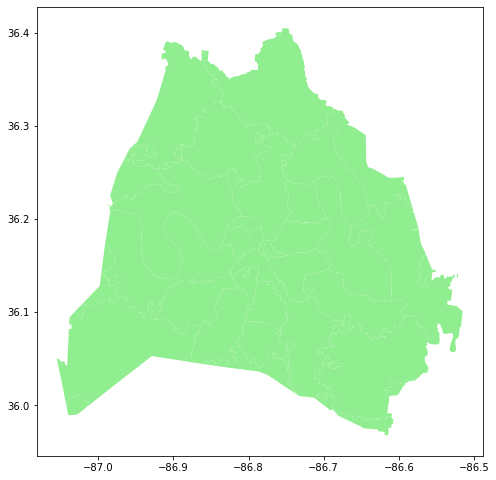

In [45]:
ax = polygon_nash.plot(figsize = (8, 10), color = 'lightgreen')
calls_by_zip.plot( ax = ax, column = 'call_type');
plt.show();

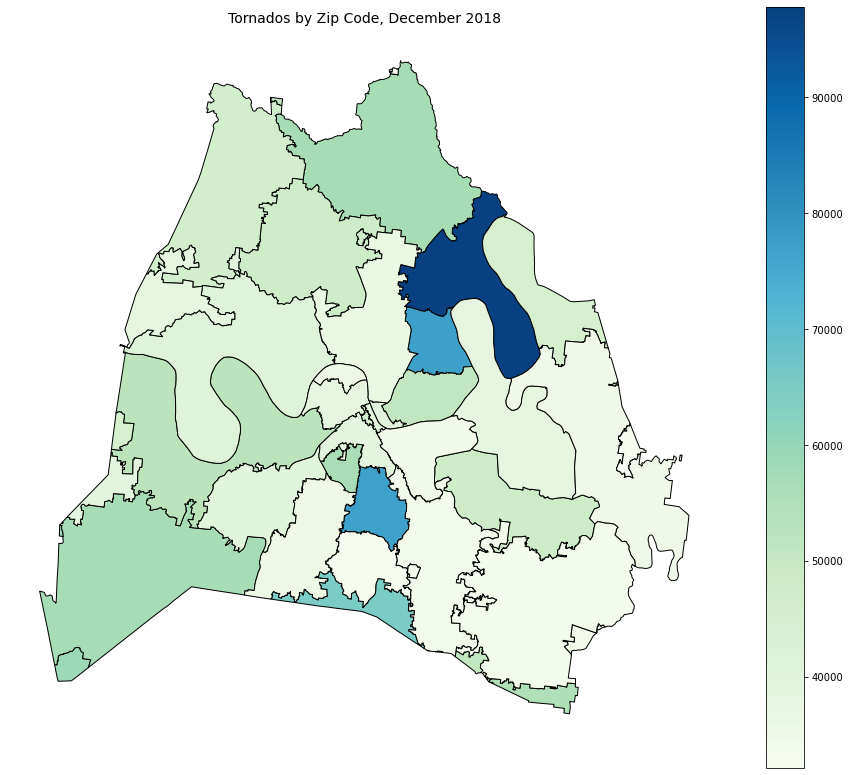

In [46]:
zip_pop_map = fig, ax = plt.subplots(figsize=(16,14))
zip_pop.plot(column = 'population', 
              cmap = 'GnBu', 
              edgecolor = 'black', 
              legend = True,
              ax = ax)
plt.title('Tornados by Zip Code, December 2018', fontsize = 14)
ax.axis('off');

### map showing tornado path

In [47]:
tornado = pd.read_csv('../data/tornado.csv')#https://www.ncdc.noaa.gov/stormevents/eventdetails.jsp?id=882999
tornado.head()

,EF_Scale,longitude,latitude,altitude
0,EF1,-84.92104,36.130070,3.0
1,EF1,-84.93339,36.131810,3.0
2,EF1,-84.94531,36.133160,3.0
3,EF1,-84.94546,36.132449,3.0
4,EF1,-84.94572,36.131999,3.0


In [48]:
tornado_force = ['EF5', 'EF4', 'EF3', 'EF2'] # here I define the strength I want to plot
tornado_lat_low = 36.168 # this is the geographic latitude range
tornado_lat_high = 36.188

#now keep only the records where strength is greater than EF1
tornado = tornado.loc[tornado['EF_Scale'].isin(tornado_force)] 
#tornado.shape

In [49]:
cluster_map_911_tornado = folium.Map(location = (36.174465,-86.767960), zoom_start = 12)
#create a marker cluster
marker_cluster = MarkerCluster().add_to(cluster_map_911_tornado)

folium.GeoJson(polygon_nash).add_to(cluster_map_911_tornado)
cluster_map_911_tornado.choropleth(
 geo_data=zipcodes,
 name='choropleth',
 data=population,
 columns=['zip', 'population'],
 key_on='feature.properties.zip',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Population'
)
folium.LayerControl().add_to(cluster_map_911_tornado)

# inside the loop add each markwe to the cluster
for row_index, row_values in tornado_calls_by_zip.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = '<b>Zip Code:</b> ' + str(row_values['zip']) + ' ' + '<b>Date/Time:</b> ' + str(row_values['date_time']) + ' ' + '<b>Address:</b> ' + str(row_values['cell_address'])
    icon=folium.Icon(color="red",icon="phone", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    
    marker.add_to(marker_cluster)
    
for ind, row in tornado.iterrows(): 
    point = [row['latitude'], row['longitude']]
    popup = 'Tornado strength ' + str(row['EF_Scale']) + ' at ' + str(row['latitude']) + ": " +str(row['longitude'])
        
    #now color format based on the strength of the tornado
    if row['EF_Scale']=="EF3":
        folium.CircleMarker(point, popup = popup, radius=5, fill=True, color='red').add_to(cluster_map_911_tornado)
    else:
        folium.CircleMarker(point, popup = popup, radius=5, fill=True, color='orange').add_to(cluster_map_911_tornado)

cluster_map_911_tornado

C:\Users\balle\Anaconda3\envs\geospatial\lib\site-packages\folium\folium.py:411: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


### cluster map for derecho calls

In [50]:
#https://www.weather.gov/ohx/20200503
derecho = pd.read_csv('../data/derecho.csv')
derecho.head()

,time,latitude,longitude,damage
0,4:35 PM,36.17,-86.78,TSTM WND DMG
1,4:35 PM,36.09,-86.80,HISTORIC 200 YEAR OLD OAK TREE BLOWN DOWN AT J...
2,4:40 PM,36.20,-86.75,TSTM WND DMG
3,4:44 PM,36.12,-86.68,TSTM WND GST - 72 mph
4,4:44 PM,36.11,-86.62,FOUR CORNERS MARINA WAS DAMAGED AS WELL AS SEV...


In [51]:
cluster_map_911_derecho = folium.Map(location = (36.174465,-86.767960), zoom_start = 12)
#create a marker cluster
marker_cluster = MarkerCluster().add_to(cluster_map_911_derecho)

folium.GeoJson(polygon_nash).add_to(cluster_map_911_derecho)
cluster_map_911_derecho.choropleth(
 geo_data=zipcodes,
 name='choropleth',
 data=population,
 columns=['zip', 'population'],
 key_on='feature.properties.zip',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Population'
)
folium.LayerControl().add_to(cluster_map_911_derecho)

# inside the loop add each markwe to the cluster
for row_index, row_values in derecho_calls_by_zip.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = '<b>Zip Code:</b> ' + str(row_values['zip']) + ' ' + '<b>Date/Time:</b> ' + str(row_values['date_time']) + ' ' + '<b>Address:</b> ' + str(row_values['cell_address'])
    #pop = str(row_values['zip'])
    icon=folium.Icon(color="red",icon="phone", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    
    marker.add_to(marker_cluster)
    
for ind, row in derecho.iterrows(): 
    point = [row['latitude'], row['longitude']]
    popup = str(row['time']) + str(row['damage']) + str(row['latitude']) + ": " +str(row['longitude'])
    folium.CircleMarker(point, popup = popup, radius=5, fill=True, color='red').add_to(cluster_map_911_derecho)

cluster_map_911_derecho


C:\Users\balle\Anaconda3\envs\geospatial\lib\site-packages\folium\folium.py:411: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


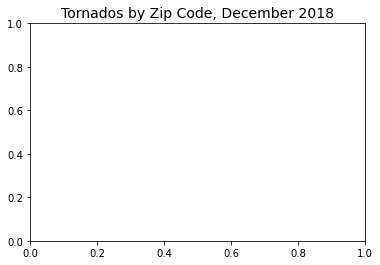

In [52]:
map_tornado = folium.Map(location = [36.173, -86.78], zoom_start = 11, tiles = 'Stamen Terrain',
    scrollWheelZoom=False)
    #tiles = 'Stamen Toner' is nice - try 'Stamen Terrain' also 'Mapbox Control Room' 'mapquestopen' 'openstreetmap'
  
plt.title('Tornados by Zip Code, December 2018', fontsize = 14)
ax.axis('off')

#marker_cluster = MarkerCluster().add_to(map_tornado)

#folium.GeoJson(polygon_nash).add_to(map_tornado)
#cluster_map_911_tornado.choropleth(
# geo_data=zipcodes,
# name='choropleth',
# data=population,
# columns=['zip', 'population'],
# key_on='feature.properties.zip',
# fill_color='YlGn',
# fill_opacity=0.7,
# line_opacity=0.2,
# legend_name='Population'
#)
#folium.LayerControl().add_to(map_tornado)

# inside the loop add each marker to the cluster
for row_index, row_values in tornado_calls_by_zip.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = str(row_values['call_type'])
    icon=folium.Icon(color="red",icon="phone", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    
    marker.add_to(marker_cluster)

for ind, row in combined_tornados.iterrows():
    # now try to only filter on those within a certain Longitude
    if row['lat'] <tornado_lat_high and row['lat']> tornado_lat_low:
        point = [row['lat'], row['lng']] 
        popup = "Type: " + str(row['type'])+" Time:" + str(row['date_time'])+ ' Address:' + str(row['address'])
        # now color format based on the type
        if row['type'] == "911 call":            
            folium.CircleMarker(point, radius=10, popup = popup, fill=True, color='green').add_to(map_tornado)
        if row['type'] == "dispatch":            
            folium.CircleMarker(point, radius=10, popup = popup, fill=True, color='darkblue').add_to(map_tornado)
        else:
            folium.CircleMarker(point, radius=10, popup = popup, 
            color= 'orange', fill=True, fill_color='lightgreen').add_to(map_tornado) 
            
for ind, row in tornado.iterrows(): 
    point = [row['latitude'], row['longitude']]
    popup = 'Tornado strength ' + str(row['EF_Scale']) + ' at ' + str(row['latitude']) + ": " +str(row['longitude'])
        
    #now color format based on the strength of the tornado
    if row['EF_Scale']=="EF3":
        folium.CircleMarker(point, popup = popup, radius=5, fill=True, color='red').add_to(map_tornado)
    else:
        folium.Circle(point, popup = popup, radius=5, fill=True, color='orange').add_to(map_tornado)
        #folium.Marker(point, popup = popup, icon = folium.Icon(color='darkred', icon='bolt', prefix='fa')).add_to(map_tornado)
    #else:
        #folium.Marker(point, popup = popup, icon = folium.Icon(color='lightred', icon='bolt', prefix='fa')).add_to(map_tornado)
    
map_tornado

In [53]:
#https://www.weather.gov/ohx/20200503
new_population = pd.read_csv('../data/new_population.csv')
new_population["population"]=new_population["population"].str.replace(',','').astype(int)
new_population.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35 entries, 0 to 34
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   zip            35 non-null     int64  
 1   population     35 non-null     int32  
 2   lat            35 non-null     float64
 3   lng            35 non-null     float64
 4   tornado_calls  35 non-null     int64  
 5   calls_per_pop  35 non-null     float64
 6   Unnamed: 6     0 non-null      float64
 7   Unnamed: 7     0 non-null      float64
dtypes: float64(5), int32(1), int64(2)
memory usage: 2.2 KB


In [65]:
new_map_911_tornado = folium.Map(location = (36.174465,-86.767960), zoom_start = 12)

#create a marker cluster
marker_cluster = MarkerCluster().add_to(new_map_911_tornado)

folium.GeoJson(polygon_nash).add_to(new_map_911_tornado)
new_map_911_tornado.choropleth(
 geo_data=zipcodes,
 name='choropleth',
 data=new_population,
 columns=['zip', 'calls_per_pop'],
 key_on='feature.properties.zip',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Population'
)
folium.LayerControl().add_to(new_map_911_tornado)

# inside the loop add each markwe to the cluster
for row_index, row_values in new_population.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = '<b>Zip Code:</b> ' + str(row_values['zip']) + ' ' + '<b>Calls:</b> ' + str(row_values['tornado_calls']) + ' ' + '<b>Population:</b> ' + str(row_values['population']) + ' ' + '<b>Call per Thousand Population:</b> ' + str(row_values['calls_per_pop'])
    icon=folium.Icon(color="red",icon="phone", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    
    marker.add_to(marker_cluster)
    
for ind, row in tornado.iterrows(): 
    point = [row['latitude'], row['longitude']]
    popup = 'Tornado strength ' + str(row['EF_Scale']) + ' at ' + str(row['latitude']) + ": " +str(row['longitude'])
        
    #now color format based on the strength of the tornado
    if row['EF_Scale']=="EF3":
        folium.CircleMarker(point, popup = popup, radius=5, fill=True, color='red').add_to(new_map_911_tornado)
    else:
        folium.CircleMarker(point, popup = popup, radius=5, fill=True, color='orange').add_to(new_map_911_tornado)

new_map_911_tornado

In [66]:
new_map_911_tornado.save('../data/new_map_911_tornado.html')

In [67]:
derecho_call_rate = pd.read_csv('../data/derecho_call_rate.csv')
derecho_call_rate.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30 entries, 0 to 29
Data columns (total 8 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   zipcode         30 non-null     int64  
 1   911_calls       30 non-null     int64  
 2   population      30 non-null     int64  
 3   call_rate       30 non-null     float64
 4   po_name         30 non-null     object 
 5   shape_stlength  30 non-null     float64
 6   shape_starea    30 non-null     float64
 7   geometry        30 non-null     object 
dtypes: float64(3), int64(3), object(2)
memory usage: 2.0+ KB


In [68]:
derecho_pop = pd.read_csv('../data/derecho_pop.csv')
derecho_pop["population"]=derecho_pop["population"].str.replace(',','').astype(int)
derecho_pop.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34 entries, 0 to 33
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   zip            34 non-null     int64  
 1   population     34 non-null     int32  
 2   lat            34 non-null     float64
 3   lng            34 non-null     float64
 4   tornado_calls  34 non-null     int64  
 5   calls_per_pop  34 non-null     float64
dtypes: float64(3), int32(1), int64(2)
memory usage: 1.6 KB


In [69]:
new_map_911_derecho = folium.Map(location = (36.174465,-86.767960), zoom_start = 12)
#create a marker cluster
marker_cluster = MarkerCluster().add_to(new_map_911_derecho)

folium.GeoJson(polygon_nash).add_to(new_map_911_derecho)
new_map_911_derecho.choropleth(
 geo_data=zipcodes,
 name='choropleth',
 data=derecho_pop,
 columns=['zip', 'calls_per_pop'],
 key_on='feature.properties.zip',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Call Rate'
)
folium.LayerControl().add_to(new_map_911_derecho)
# inside the loop add each markwe to the cluster
for row_index, row_values in derecho_pop.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = '<b>Zip Code:</b> ' + str(row_values['zip']) + ' ' + '<b>Calls:</b> ' + str(row_values['tornado_calls']) + ' ' + '<b>Population:</b> ' + str(row_values['population']) + ' ' + '<b>Call per Thousand Population:</b> ' + str(row_values['calls_per_pop'])
    icon=folium.Icon(color="red",icon="phone", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    
    marker.add_to(marker_cluster)
                                                                                          
for ind, row in derecho.iterrows():
    point = [row['latitude'], row['longitude']]
    popup = str(row['time']) + str(row['damage']) + str(row['latitude']) + ": " +str(row['longitude'])
    folium.CircleMarker(point, popup = popup, radius=5, fill=True, color='red').add_to(new_map_911_derecho)
new_map_911_derecho

In [70]:
new_map_911_derecho.save('../data/new_map_911_derecho.html')